## Projekt 2 - Klasteryzacja
### Human Activity Recognition Using Smartphones Data Set
#### Milestone 3 - Finalne modele

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.cm as cm
import itertools

from matplotlib import pyplot as plt

from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.mixture import GaussianMixture
from sklearn.manifold import TSNE
from sklearn.metrics import davies_bouldin_score, silhouette_score, silhouette_samples, calinski_harabasz_score
from sklearn.neighbors import NearestNeighbors

from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer
from yellowbrick.cluster import SilhouetteVisualizer, silhouette_visualizer
from sklearn.cluster import AgglomerativeClustering

from scipy.cluster.hierarchy import dendrogram

from sklearn.metrics import accuracy_score
import scipy
from functools import partial

import warnings
warnings.filterwarnings('ignore')

In [3]:
train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')

merged = pd.concat([train, test])
original_labels = merged['Activity']
X = merged.drop(['subject', 'Activity'], axis=1)

X.head()

,tBodyAcc-mean()-X,tBodyAcc-mean()-Y,tBodyAcc-mean()-Z,tBodyAcc-std()-X,tBodyAcc-std()-Y,tBodyAcc-std()-Z,tBodyAcc-mad()-X,tBodyAcc-mad()-Y,tBodyAcc-mad()-Z,tBodyAcc-max()-X,...,fBodyBodyGyroJerkMag-meanFreq(),fBodyBodyGyroJerkMag-skewness(),fBodyBodyGyroJerkMag-kurtosis(),"angle(tBodyAccMean,gravity)","angle(tBodyAccJerkMean),gravityMean)","angle(tBodyGyroMean,gravityMean)","angle(tBodyGyroJerkMean,gravityMean)","angle(X,gravityMean)","angle(Y,gravityMean)","angle(Z,gravityMean)"
0,0.288585,-0.020294,-0.132905,-0.995279,-0.983111,-0.913526,-0.995112,-0.983185,-0.923527,-0.934724,...,-0.074323,-0.298676,-0.710304,-0.112754,0.030400,-0.464761,-0.018446,-0.841247,0.179941,-0.058627
1,0.278419,-0.016411,-0.123520,-0.998245,-0.975300,-0.960322,-0.998807,-0.974914,-0.957686,-0.943068,...,0.158075,-0.595051,-0.861499,0.053477,-0.007435,-0.732626,0.703511,-0.844788,0.180289,-0.054317
2,0.279653,-0.019467,-0.113462,-0.995380,-0.967187,-0.978944,-0.996520,-0.963668,-0.977469,-0.938692,...,0.414503,-0.390748,-0.760104,-0.118559,0.177899,0.100699,0.808529,-0.848933,0.180637,-0.049118
3,0.279174,-0.026201,-0.123283,-0.996091,-0.983403,-0.990675,-0.997099,-0.982750,-0.989302,-0.938692,...,0.404573,-0.117290,-0.482845,-0.036788,-0.012892,0.640011,-0.485366,-0.848649,0.181935,-0.047663
4,0.276629,-0.016570,-0.115362,-0.998139,-0.980817,-0.990482,-0.998321,-0.979672,-0.990441,-0.942469,...,0.087753,-0.351471,-0.699205,0.123320,0.122542,0.693578,-0.615971,-0.847865,0.185151,-0.043892


In [9]:
pca = PCA(n_components=0.95, random_state=0)
pca.fit(X)
X_pca = pca.transform(X)

pca2 = PCA(n_components=0.90, random_state=0)
pca2.fit(X)
X_pca2 = pca.transform(X)

pca3 = PCA(n_components=0.8, random_state=0)
pca3.fit(X)
X_pca3 = pca.transform(X)

### Klastrowanie hierarchiczne

In [10]:
def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack([model.children_, model.distances_,
                                      counts]).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)

In [11]:
linkages = ['ward', 'complete', 'average', 'single']

#### PCA `n_components = 69` 95% EVR

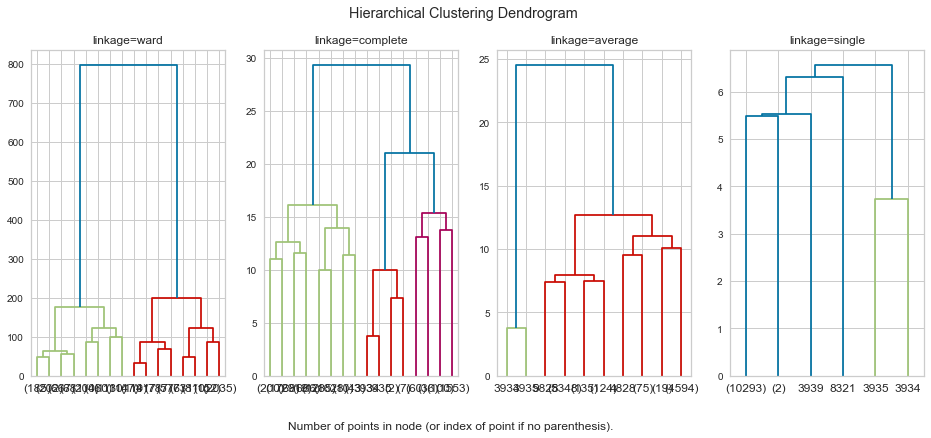

In [12]:
models_ = [partial(AgglomerativeClustering, distance_threshold=0, n_clusters=None, linkage=x) for x in linkages]

models = [model().fit(X_pca) for model in models_]

fig, axs = plt.subplots(1, 4, figsize=(16, 6))
fig.suptitle('Hierarchical Clustering Dendrogram')
# plot the top three levels of the dendrogram
for i in range(4):
    plot_dendrogram(models[i], truncate_mode='level', p=3, ax=axs[i])
    axs[i].set_title("linkage="+models_[i].keywords['linkage'])
axs[1].text(20, -5, "Number of points in node (or index of point if no parenthesis).")
plt.show()

#### PCA `n_components = 35` 90% EVR

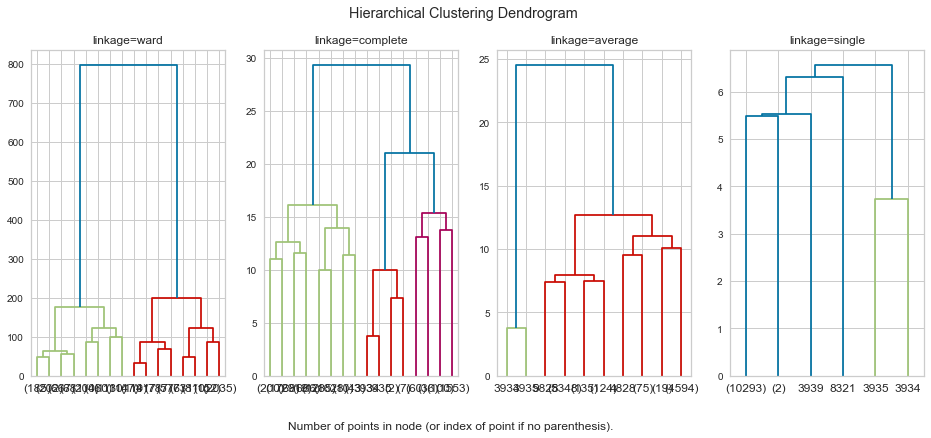

In [16]:
models_ = [partial(AgglomerativeClustering, distance_threshold=0, n_clusters=None, linkage=x) for x in linkages]

models = [model().fit(X_pca2) for model in models_]

fig, axs = plt.subplots(1, 4, figsize=(16, 6))
fig.suptitle('Hierarchical Clustering Dendrogram')
# plot the top three levels of the dendrogram
for i in range(4):
    plot_dendrogram(models[i], truncate_mode='level', p=3, ax=axs[i])
    axs[i].set_title("linkage="+models_[i].keywords['linkage'])
axs[1].text(20, -5, "Number of points in node (or index of point if no parenthesis).")
plt.show()

#### PCA `n_components = 11` 80% EVR

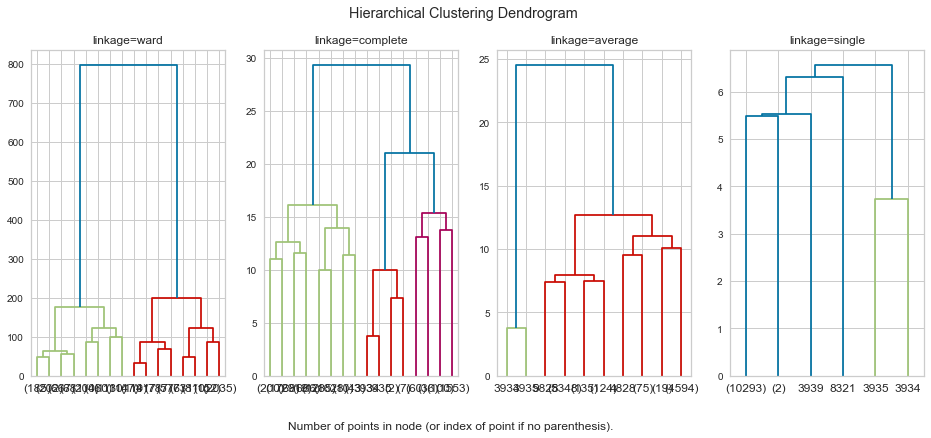

In [15]:
models_ = [partial(AgglomerativeClustering, distance_threshold=0, n_clusters=None, linkage=x) for x in linkages]

models = [model().fit(X_pca3) for model in models_]

fig, axs = plt.subplots(1, 4, figsize=(16, 6))
fig.suptitle('Hierarchical Clustering Dendrogram')
# plot the top three levels of the dendrogram
for i in range(4):
    plot_dendrogram(models[i], truncate_mode='level', p=3, ax=axs[i])
    axs[i].set_title("linkage="+models_[i].keywords['linkage'])
axs[1].text(20, -5, "Number of points in node (or index of point if no parenthesis).")
plt.show()

### DBSCAN

In [20]:
eps = [i / 10 for i in range(5, 60, 10)]

dbs = []
db_models = []

for i in range(len(eps)):
    db = DBSCAN(eps=eps[i], min_samples=10).fit(X)
    db_models.append(db)

    dbs.append(db.fit_predict(X_pca3))

In [23]:
tSNE = TSNE(random_state=0, verbose=0)
y_tsne = tSNE.fit_transform(X_pca3)

In [39]:
def plot_dbscan(i):
    y = dbs[i]
    
    fig, axes = plt.subplots(figsize=(6, 6))

    sns.scatterplot(ax=axes, x=y_tsne[:, 0], y=y_tsne[:, 1], hue=y, palette='tab10')

    plt.title(f'Clusters from DBScan with eps = {eps[i]}')

    plt.show()

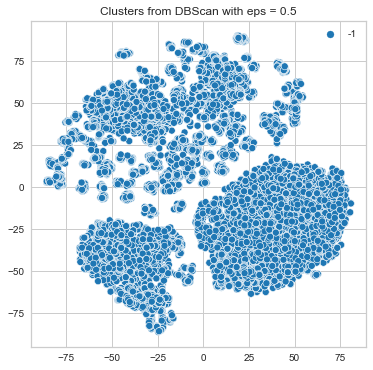

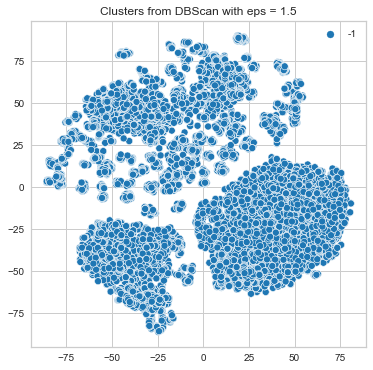

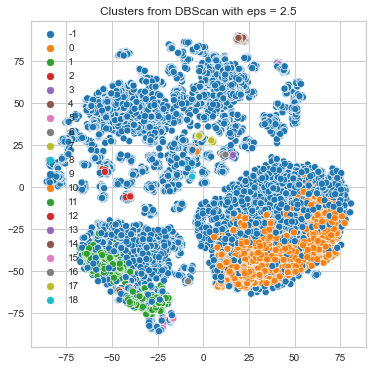

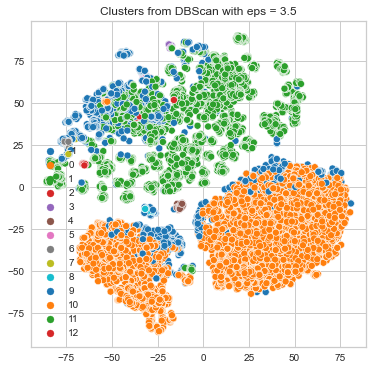

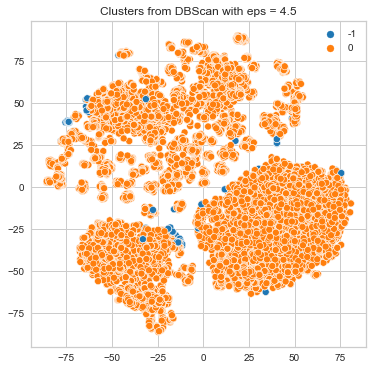

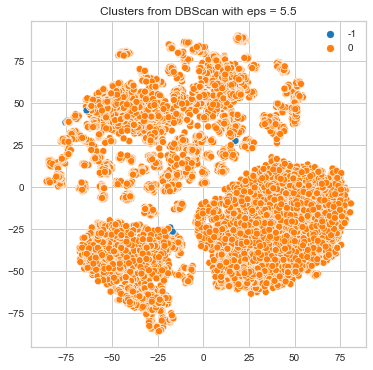

In [40]:
for i in range(len(eps)):
    plot_dbscan(i)

### Gaussian mixture models

`n_components = 2`

In [42]:
gm = GaussianMixture(n_components=2, random_state=0)
y = gm.fit_predict(X_pca3)

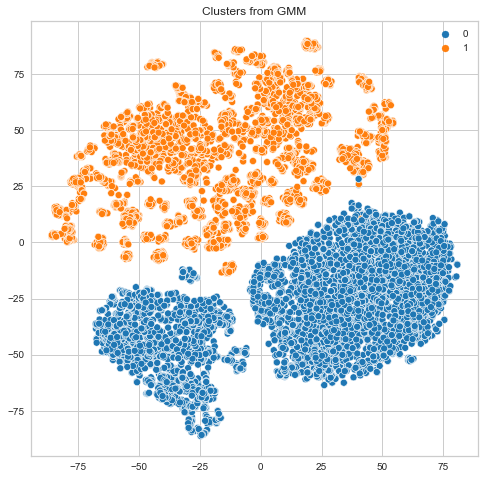

In [44]:
fig, axes = plt.subplots(figsize=(8, 8))

sns.scatterplot(ax=axes, x=y_tsne[:, 0], y=y_tsne[:, 1], hue=y, palette='tab10')

plt.title(f'Clusters from GMM')

plt.show()

`n_components = 4`

In [45]:
gm = GaussianMixture(n_components=4, random_state=0)
y = gm.fit_predict(X_pca3)

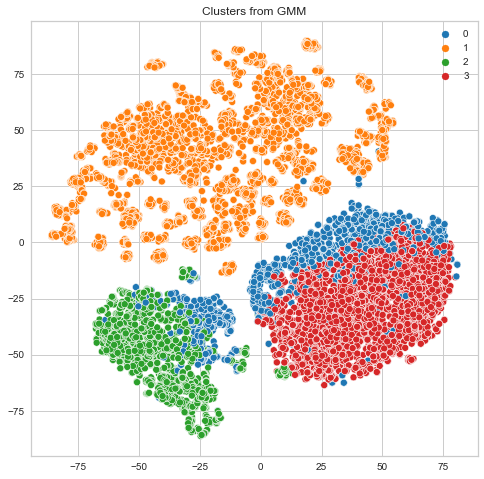

In [47]:
fig, axes = plt.subplots(figsize=(8, 8))

sns.scatterplot(ax=axes, x=y_tsne[:, 0], y=y_tsne[:, 1], hue=y, palette='tab10')

plt.title(f'Clusters from GMM')

plt.show()

### Podsumowanie

In [50]:
activities = original_labels.unique()
activities

array(['STANDING', 'SITTING', 'LAYING', 'WALKING', 'WALKING_DOWNSTAIRS',
       'WALKING_UPSTAIRS'], dtype=object)

In [49]:
# activities = original_labels.unique()
y = dict()

def map_activities(data, activities, labels):
    map = dict()
    for activity, label in zip(activities, labels):
        map[activity]=label
    return data.map(map)

# podzial na 'k' klastrów (dlaczego tak, wybrane na podstawie wykresow (tsne) i znajdujacej sie na koncu identyfikacji klastrow)

y['2']=map_activities(original_labels, activities, [0,0,0,1,1,1])
y['3']=map_activities(original_labels, activities, [0,0,0,1,2,1])
y['4']=map_activities(original_labels, activities, [0,0,1,2,3,2])

def find_permutation(n_clusters, y, labels):
    permutation=[]
    real_labels = y[str(n_clusters)]
    for i in range(n_clusters):
        idx = labels == i
        new_label=scipy.stats.mode(real_labels[idx])[0][0]  # Choose the most common label among data points in the cluster
        permutation.append(new_label)
    return permutation

def my_accuracy(y, labels, n_clusters):
    
    real_labels = y[str(n_clusters)]
    permutation = find_permutation(n_clusters, y, labels)
    new_labels = [permutation[label] for label in labels]
    
    return accuracy_score(real_labels, new_labels)

def count_accuracy(X, model, y, n_clusters):
    try:
        model_instance = model(n_components=n_clusters)
    except:
        model_instance = model(n_clusters=n_clusters)
    
    labels = model_instance.fit_predict(X)
    
    return my_accuracy(y, labels, n_clusters)

metrices = {
    'silhouette': silhouette_score,
    'davies-bouldin': davies_bouldin_score,
    'calinski-harabasz': calinski_harabasz_score,
    'accuracy': my_accuracy
}

models = {
    'Kmeans': KMeans,
    'Gaussian Mixture Models': GaussianMixture 
}
models_2 = {
    'Agglomerative ward linkage': partial(AgglomerativeClustering, linkage='ward'),
    'Agglomerative complete linkage': partial(AgglomerativeClustering, linkage='complete'),
    'Agglomerative average linkage': partial(AgglomerativeClustering, linkage='average'),
    'Agglomerative single linkage': partial(AgglomerativeClustering, linkage='single')
}
all_models = {
    **models,
    **models_2
}

data = {
    'PCA 69 components (95%% EVA)': X_pca,
    'PCA 35 components (90%% EVA)': X_pca2,
    'PCA 11 components (80%% EVA)': X_pca3,
}

cluster_num = [2, 3, 4]
cluster_num_2=[2]


somelists = [data, models, cluster_num]
somelists2 = [data, models_2, cluster_num_2]

def count_clustering_scores(X, cluster_num, model, score_fun):
    if isinstance(cluster_num, int):
        cluster_num_iter = [cluster_num]
    else:
        cluster_num_iter = cluster_num
        
    scores = []    
    for k in cluster_num_iter:
        try:
            model_instance = model(n_components=k)
        except:
            model_instance = model(n_clusters=k)
        labels = model_instance.fit_predict(X)
        wcss = score_fun(X, labels)
        scores.append(wcss)
    
    if isinstance(cluster_num, int):
        return scores[0]
    else:
        return scores
a = [list(x) for x in itertools.product(*somelists2)]
a = pd.DataFrame(a)
a[2] = [2,3,3,2]*3
a = [tuple(list) for list in a.values]
index =  pd.MultiIndex.from_tuples([x for x in itertools.product(*somelists)] + a)

df = pd.DataFrame(index = index)

for row in index:
    for metric_key in metrices:
        if metric_key=='accuracy':
            df.loc[row, metric_key] = count_accuracy(X=data[row[0]],
                                                     model=all_models[row[1]],
                                                     y=y,
                                                     n_clusters=row[2])
            continue
        df.loc[row, metric_key] = count_clustering_scores(X=data[row[0]], cluster_num=row[2],
                                                          model=all_models[row[1]],
                                                          score_fun=metrices[metric_key])

df.sort_index(ascending=[False,False,True])

silhouette  \
PCA 69 components (95%% EVA) Kmeans                         2    0.504670   
                                                            3    0.343645   
                                                            4    0.205862   
                             Gaussian Mixture Models        2    0.504237   
                                                            3    0.330909   
                                                            4    0.137688   
                             Agglomerative ward linkage     2    0.503997   
                             Agglomerative single linkage   2    0.594533   
                             Agglomerative complete linkage 3    0.262647   
                             Agglomerative average linkage  3    0.500601   
PCA 35 components (90%% EVA) Kmeans                         2    0.504670   
                                                            3    0.343645   
                                                            4    0.205862   
                             Gaussian Mixture Models        2    0.504237   
                                                            3    0.330909   
                                                            4    0.288073   
                             Agglomerative ward linkage     2    0.503997   
                             Agglomerative single linkage   2    0.594533   
                             Agglomerative complete linkage 3    0.262647   
                             Agglomerative average linkage  3    0.500601   
PCA 11 components (80%% EVA) Kmeans                         2    0.504670   
                                                            3    0.343152   
                                                            4    0.205772   
                             Gaussian Mixture Models        2    0.504237   
                                                            3    0.321699   
                                                            4    0.288073   
                             Agglomerative ward linkage     2    0.503997   
                             Agglomerative single linkage   2    0.594533   
                             Agglomerative complete linkage 3    0.262647   
                             Agglomerative average linkage  3    0.500601   

                                                               davies-bouldin  \
PCA 69 components (95%% EVA) Kmeans                         2        0.792377   
                                                            3        1.550655   
                                                            4        1.892153   
                             Gaussian Mixture Models        2        0.792963   
                                                            3        1.669581   
                                                            4        1.975674   
                             Agglomerative ward linkage     2        0.793327   
                             Agglomerative single linkage   2        0.373060   
                             Agglomerative complete linkage 3        0.978491   
                             Agglomerative average linkage  3        0.640262   
PCA 35 components (90%% EVA) Kmeans                         2        0.792377   
                                                            3        1.550963   
                                                            4        1.892348   
                             Gaussian Mixture Models        2        0.792963   
                                                            3        1.504405   
                                                            4        1.778222   
                             Agglomerative ward linkage     2        0.793327   
                             Agglomerative single linkage   2        0.373060   
                             Agglomerative complete linkage 3        0.978491   
                             Agglomerative average link

Według metryki silhouette najlepsze wyniki otrzymujemy dla `Agglomerative single linkage` jednak jeśli przyjrzymy się oryginalnym labelom to model ma accuracy tylko 54%. Sporo modeli osiąga silhouette score na poziomie 0.5

Według metryki david-bouldin najlepszy jest małowymiarowy GMM z 4 klastrami.

Według metryki caliniski-harabsz najlepsze są modele z dwoma klastrami, wymiarowość nie wpływa znacząco na wynik.

### Wizualizacje wybranych modeli i porównanie z oryginalnymi klasami

#### GMM 4 klastry, 80% EVR

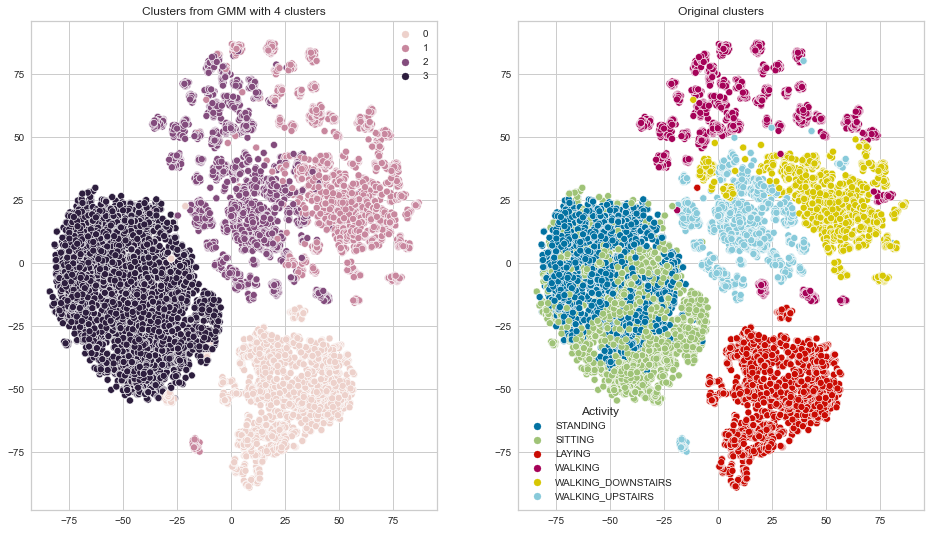

In [62]:
clustering = GaussianMixture(n_components=4)
y = clustering.fit_predict(X_pca3)

random_state = 4
tSNE = TSNE(random_state=random_state, verbose=0)
y_tsne = tSNE.fit_transform(X_pca3)

fig, axs = plt.subplots(1, 2,figsize=(16, 9))
sns.scatterplot(ax=axs[0],x=y_tsne[:, 0], y=y_tsne[:, 1], hue=y)
sns.scatterplot(ax=axs[1],x=y_tsne[:, 0], y=y_tsne[:, 1], hue=original_labels)
axs[0].set_title(f'Clusters from GMM with 4 clusters')
axs[1].set_title('Original clusters')
plt.show()

### Agglomerative ward linkage 80% EVR

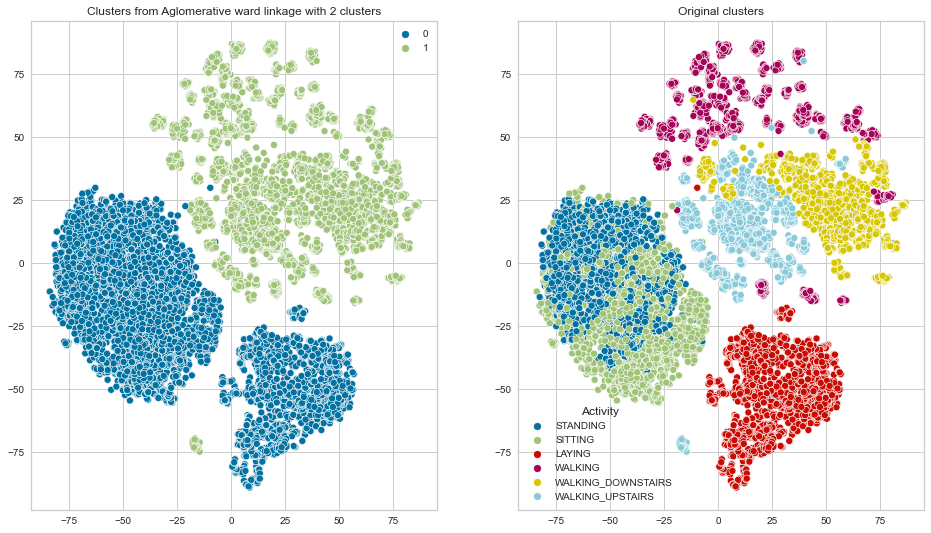

In [64]:
clustering = AgglomerativeClustering(linkage='ward')
y = clustering.fit_predict(X_pca3)

random_state = 4
tSNE = TSNE(random_state=random_state, verbose=0)
y_tsne = tSNE.fit_transform(X_pca3)

fig, axs = plt.subplots(1, 2,figsize=(16, 9))
sns.scatterplot(ax=axs[0],x=y_tsne[:, 0], y=y_tsne[:, 1], hue=y)
sns.scatterplot(ax=axs[1],x=y_tsne[:, 0], y=y_tsne[:, 1], hue=original_labels)
axs[0].set_title(f'Clusters from Aglomerative ward linkage with 2 clusters')
axs[1].set_title('Original clusters')
plt.show()

Mamy więc dwa typy podziałów:
- 2 klastry, aktywności stacjonarne (SITTING, STANDING, LAYING) i dynamiczne (WALKING, WALKING_UPSTAIRS, WALKING_DOWNSTAIRS)
- 4 klastry
    - SITTING, STANDING
    - LAYING
    - WALKING_DOWNSTAIRS, WALKING_UPSTAIRS